In [1]:
import open3d as o3d
import numpy as np

点群データ

In [2]:
pointcloud = o3d.io.read_point_cloud("./bunny.pcd")
if pointcloud.is_empty():
    exit()

In [3]:
print(pointcloud)

PointCloud with 397 points.


In [4]:
# 全ての点の法線を計算
pointcloud.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.1, max_nn=30))

In [ ]:
# python逝く
# o3d.visualization.draw_geometries([pointcloud])

In [6]:
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

In [7]:
points = np.asarray(pointcloud.points)

In [10]:
colors = None
if pointcloud.has_colors():
    colors = np.asarray(pointcloud.colors)
elif pointcloud.has_normals():
    colors = (0.5, 0.5, 0.5) + np.asarray(pointcloud.normals)*0.5
else:
    geometry.paint_uniform_color((1.0, 0.0, 0.0))
    colors = np.asarray(geometry.colors)

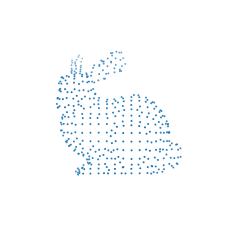

In [15]:
# single view
data1 = plt.axes(projection='3d')
data1.view_init(90, -90)
data1.axis("off")
# data1.scatter(points[:, 0], points[:, 1], points[:, 2], s=1, c=colors)
data1.scatter(points[:, 0], points[:, 1], points[:, 2], s=1)
plt.show()

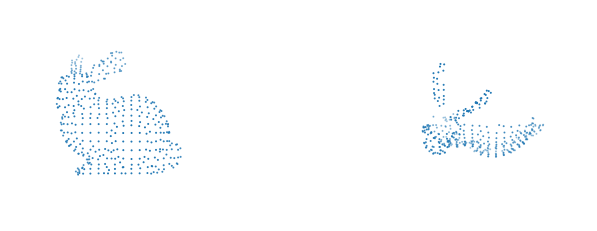

In [20]:
# Multi View
figsize = plt.rcParams.get('figure.figsize')
fig = plt.figure(figsize=(figsize[0] * 2, figsize[1]))
data2 = fig.add_subplot(1, 2, 1, projection = '3d')
data3 = fig.add_subplot(1, 2, 2, projection = '3d')
data2.axis("off")
data2.view_init(90, -90)
data2.scatter(points[:, 0], points[:, 1], points[:, 2], s=1)
data3.axis("off")
data3.view_init(90+90, -90)
data3.scatter(points[:, 0], points[:, 1], points[:, 2], s=1)
plt.show()

In [22]:
import plotly.graph_objects as go

In [23]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=points[:,0], y=points[:,1], z=points[:,2], 
            mode='markers',
            marker=dict(size=1, color=colors)
        )
    ],
    layout=dict(
        scene=dict(
            xaxis=dict(visible=False),
            yaxis=dict(visible=False),
            zaxis=dict(visible=False)
        )
    )
)
fig.show()

メッシュデータ

In [25]:
mesh = o3d.io.read_triangle_mesh("./bunny.obj")
if mesh.is_empty():
    exit()

In [26]:
triangles = np.asarray(mesh.triangles)
vertices = np.asarray(mesh.vertices)

In [29]:
if not mesh.has_vertex_normals(): mesh.compute_vertex_normals()
if not mesh.has_triangle_normals(): mesh.compute_triangle_normals()

In [30]:
colors = None
if mesh.has_triangle_normals():
    colors = (0.5, 0.5, 0.5) + np.asarray(mesh.triangle_normals) * 0.5
    colors = tuple(map(tuple, colors))
else:
    colors = (1.0, 0.0, 0.0)

In [31]:
fig = go.Figure(
    data=[
        go.Mesh3d(
            x=vertices[:,0],
            y=vertices[:,1],
            z=vertices[:,2],
            i=triangles[:,0],
            j=triangles[:,1],
            k=triangles[:,2],
            facecolor=colors,
            opacity=0.50)
    ],
    layout=dict(
        scene=dict(
            xaxis=dict(visible=False),
            yaxis=dict(visible=False),
            zaxis=dict(visible=False)
        )
    )
)
fig.show()